# Machine Learning Coursework 2023
Code for completion of machine learning coursework 2023

In [91]:
#Import dataset
import os

data_path = "./activity_recognition_dataset/S1_Dataset"

files = os.listdir(data_path)
print(files)

['d1p08F', 'd1p26F', 'd1p46M', 'd1p30F', 'd1p44M', 'd1p34F', 'd1p14F', 'd1p37M', 'd1p45M', 'd1p16F', 'd1p28F', 'd1p58F', 'd1p31F', 'd1p05M', 'd1p03M', 'd1p23F', 'd1p17F', 'd1p35F', 'd1p22F', 'd1p49F', 'd1p12F', 'd1p47M', 'd1p06M', 'd1p29F', 'd1p19F', 'd1p27F', 'd1p21F', 'd1p13F', 'd1p48M', 'd1p15F', 'd1p59F', 'd1p01M', 'd1p42M', 'd1p04M', 'd1p11F', 'd1p53F', 'd1p33F', 'd1p57F', 'd1p39M', 'd1p20F', 'd1p50F', 'd1p38M', 'd1p56F', 'd1p52F', 'd1p07M', 'd1p32F', 'd1p60F', 'd1p51F', 'd1p55F', 'd1p40M', 'd1p41M', 'd1p54F', 'd1p10F', 'd1p36M', 'd1p02M', 'd1p09F', 'd1p25F', '.ipynb_checkpoints', 'README.txt', 'd1p18F', 'd1p43M', 'd1p24F']


In [92]:
import pandas as pd  # use pandas to load data from CSV files

combined_data = []

for file in files:
    
    if file == "README.txt":
        continue
    
    try:
        # load a single sequence from the file
        seq_dataframe = pd.read_csv(os.path.join(data_path, file), header=None, names=["time", "frontal acc", "vertical acc", "lateral acc", "antenna ID", "RSSI", "phase", "frequency", "label"])
        
        # put the ID of the sequence into the dataframe as an extra column
        seq_dataframe['seqID'] = file  # use filename as ID
                
        combined_data.append(seq_dataframe)  # put the data frame into a list
    except:
        print(f"Could not load file {file}. Skipping.")

Could not load file .ipynb_checkpoints. Skipping.


In [93]:
import numpy as np

# the pandas dataframe stores data in a table with headers
input_cols = ["frontal acc", "vertical acc", "lateral acc", "RSSI", "phase", "frequency"]  # column headers for the input features
output_col = "label"  # column header for the output label

# get the relevant columns from the pandas dataframes and convert to numpy arrays
X_by_seq = []  # store a list of numpy arrays containing the input features for each sequence
y_by_seq = []  # store a list of 1-D numpy arrays containing the target activity labels for each sequence

for seq_table in combined_data:
    X_by_seq.append(seq_table[input_cols].values)
    y_by_seq.append(seq_table[output_col].values - 1)    # subtract one from the label so that labels start from 0
    
n_states = np.unique(np.concatenate(y_by_seq)).size  # how many classes/states are there?

In [94]:
from sklearn.model_selection import train_test_split

# create train/test split. Sequences are kept complete.
X_by_seq_tr, X_by_seq_test, y_by_seq_tr, y_by_seq_test = train_test_split(X_by_seq, y_by_seq, test_size=0.2, random_state=21)  # You may wish to make further splits of the data or to modify this split.

In [81]:
# Record which observations occur given each state (activity label)
X_given_y = [[] for _ in range(n_states)]  # empty list where we will record the observations that occur given each activity label

for s, X_seq in enumerate(X_by_seq_tr):
    for i in range(X_seq.shape[0]):
        state_i = y_by_seq_tr[s][i]
        X_given_y[state_i].append(X_seq[i, :][None, :])

In [82]:
from hmmlearn import hmm  # We recommend using this class if builing an HMM

# Record the mean feature values for observations in each state
means = np.zeros((n_states, len(input_cols)))

# Record the variance of feature values for observations in each state
diagonal_covars = np.zeros((n_states, len(input_cols)))

for state in range(n_states):
    means[state] = np.mean(X_given_y[state], axis=0)
    diagonal_covars[state, :] = np.var(X_given_y[state], axis=0)

In [83]:
X_tr = np.concatenate(X_by_seq_tr, axis=0)  # combine features into one matrix -- use this as input features for training a classifier
y_tr = np.concatenate(y_by_seq_tr)  # combine target labels into one list -- use this as target labels for training a classifier
X_test = np.concatenate(X_by_seq_test, axis=0)  # combine features into one matrix -- use this as input features for testing a classifier
y_test = np.concatenate(y_by_seq_test)  # combine target labels into one list -- use this as target labels for evaluating a classifier

# Task 1a Neural Network Classifier (12 Marks)

* a Train a neural network classifier and plot training and validation learning curves. (3 Marks)

In [95]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression

print(X_tr.shape)
print(y_tr.shape)
print(X_test.shape)
print(y_test.shape)

train_X_flatten = np.reshape(X_tr.shape[0],-1)
train_y_flatten = np.reshape(y_tr.shape[0],-1)
print(train_X_flatten.shape)
print(train_y_flatten.shape)

logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_tr, y_tr.flatten())
print('Training accuracy: ', round(logreg.score(X_tr, y_tr.flatten()),2))
print('Testing accuracy: ', round(logreg.score(X_test, y_test.flatten()),2))

(37224, 6)
(37224,)
(15258, 6)
(15258,)
(1,)
(1,)
Training accuracy:  0.89
Testing accuracy:  0.88


In [96]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import learning_curve
from sklearn.metrics import log_loss
import warnings
from sklearn.exceptions import ConvergenceWarning

warnings.filterwarnings("ignore", category=ConvergenceWarning)

def mlp_train():
    mlp = MLPClassifier(early_stopping = True)
    mlp.fit(X_tr,y_tr)
    return mlp

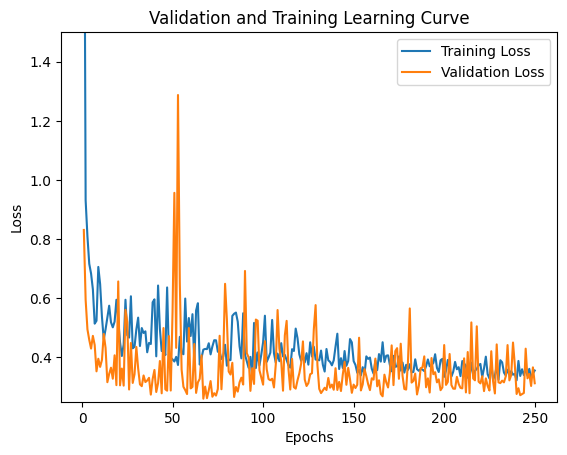

In [88]:

# Suppress only the ConvergenceWarnings specifically for sklearn
warnings.filterwarnings("ignore", category=ConvergenceWarning)

def validation_mlp(hls, epochs, batch_size, act_func, momentum, solver, decay):
    mlp = MLPClassifier(hidden_layer_sizes=hls, solver = solver, batch_size = batch_size, activation = act_func,  max_iter=1, warm_start=True)
    
    # Set the number of epochs
    
    train_losses = []
    val_losses = []
    train_scores = []
    val_scores = []
    train_stds = []
    val_stds =[]
    train_sizes = np.arange(1, epochs+ 1, 1)
    
    for i in range(epochs):
        mlp.fit(X_tr, y_tr)
        val_indices = np.random.choice(X_tr.shape[0], size=int(np.round(0.1*(X_tr.shape[0]))), replace=False)
        X_val, y_val = X_tr[val_indices], y_tr[val_indices]
        # train_pred = mlp.predict_proba(X_tr)
        val_pred = mlp.predict_proba(X_val)
    
        # train_loss = log_loss(y_tr, train_pred)
        val_loss = log_loss(y_val, val_pred)
    
        # train_losses.append(train_loss)
        val_losses.append(val_loss)
        
        # train_mean = np.mean(train_losses)
        val_mean = np.mean(val_losses)
        # train_std = np.std(train_losses)
        val_std = np.std(val_losses)
        
        # train_scores.append(train_mean)
        val_scores.append(val_mean)
        # train_stds.append(train_std)
        val_stds.append(val_std)

    
    # train_stds = np.array(train_stds)
    val_stds = np.array(val_stds)
    # train_scores = np.array(train_scores)
    val_scores = np.array(val_scores)

    train_scores = mlp.loss_curve_
    
    # plt.fill_between(train_sizes, train_scores - train_stds, train_scores + train_stds, alpha = 0.2)
    # plt.fill_between(train_sizes, val_scores - val_stds, val_scores + val_stds, alpha = 0.2)
    
    
   
    # plt.show()
    return mlp, train_scores, val_losses, train_sizes

mlp, train_scores, val_losses, train_sizes= validation_mlp((100,), 250, 'auto', 'relu', 0.9, 'adam', 0.9)
plt.plot(train_sizes, train_scores, label="Training Loss")
plt.plot(train_sizes, val_losses, label="Validation Loss")

# plt.plot(train_sizes, train_losses, label='Training Loss')
# plt.plot(train_sizes, val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation and Training Learning Curve')
# plt.title(('Learning Curve: HLS:', hls, "epochs: ", epochs, "solver: ", solver, "batch size: ", batch_size, "activation: ", act_func))
plt.legend()
plt.savefig('./learning_curve2.png')
plt.ylim(0.25, 1.5)
plt.show()

# Task 1b Neural Network Classifier (12 Marks)

* Present and briefly discuss your results on the test set. (2 Marks)

Accuracy:  0.5998164897103159


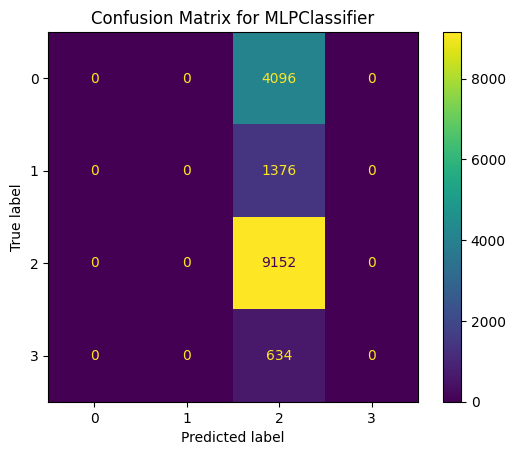

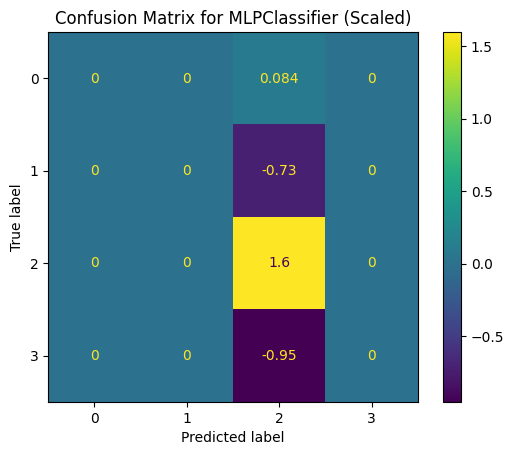

[0.586568166554735 0.586433848220282 0.586433848220282 0.586433848220282
 0.586512627619559]


In [97]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score

from sklearn.preprocessing import StandardScaler

#Calculate accuracy

pred_y = mlp.predict(X_test)
accuracy = accuracy_score(y_test, pred_y)
print("Accuracy: ",accuracy)

#Make Confusion Matrix
scaler = StandardScaler()

cm = confusion_matrix(y_test, pred_y)
display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=mlp.classes_)
ax = display.plot().ax_
ax.set_title("Confusion Matrix for MLPClassifier")
plt.show()
cm = scaler.fit_transform(cm)

display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=mlp.classes_)
ax = display.plot().ax_
ax.set_title("Confusion Matrix for MLPClassifier (Scaled)")
plt.show()

#Calculate Cross Validation Scores
cross_val_scores = cross_val_score(mlp, X_tr, y_tr, cv=5)
print(cross_val_scores)


# Task 1c Neural Network Classifier (12 Marks)

* Which hyperparameters have the strongest effect on model performance? Use plots to help you investigate this. (7 Marks)

In [98]:
hls_l = [(20,),(100,),(20,20),(100,100)]
# epochs_list = [20,40,60,80,100]
batch_sizes = [16, 32, 64, 128]
act_funcs = ['relu', 'tanh', 'logistic']




for h in hls_l:
    print(h)
    mlp, train_scores, val_losses, train_sizes = validation_mlp(h, 50, 'auto', 'relu', 0.9, 'adam', 0.9)
    plt.plot(train_sizes, train_scores, label=f"Training Loss {h}")
    # plt.plot(train_sizes, val_losses, label=f"Validation Loss {}")

# plt.plot(train_sizes, train_losses, label='Training Loss')
# plt.plot(train_sizes, val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation and Training Learning Curve for HLS')
# plt.title(('Learning Curve: HLS:', hls, "epochs: ", epochs, "solver: ", solver, "batch size: ", batch_size, "activation: ", act_func))
plt.legend()
plt.show()

for batch_size in batch_sizes:
    print(batch_size)
    mlp, train_scores, val_losses, train_sizes =validation_mlp((100,), 50, batch_size, 'relu', 0.9, 'adam', 0.9)
    plt.plot(train_sizes, train_scores, label=f"Training Loss {batch_size}")

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation and Training Learning Curve for batch size')
# plt.title(('Learning Curve: HLS:', hls, "epochs: ", epochs, "solver: ", solver, "batch size: ", batch_size, "activation: ", act_func))
plt.legend()
plt.show()

for act_func in act_funcs:
    mlp, train_scores, val_losses, train_sizes = validation_mlp((100,), 50, 'auto', act_func, 0.9, 'adam', 0.9)
    plt.plot(train_sizes, train_scores, label=f"Training Loss {act_func}")

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation and Training Learning Curve for activation function')
# plt.title(('Learning Curve: HLS:', hls, "epochs: ", epochs, "solver: ", solver, "batch size: ", batch_size, "activation: ", act_func))
plt.legend()
plt.show()

(20,)


KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

# Task 2a - Ensemble and decision trees (18 marks)

* Train an ensemble of decision trees, and briefly describe how your ensemble improves performance over a single model. (2 marks)

In [99]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.datasets import fetch_openml

from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

import random

import graphviz

In [100]:

max_depths = [1,5,10,15,20]

for d in max_depths:
    model = DecisionTreeClassifier(max_depth=d)
    model.fit(X_tr, y_tr)
    print(f'Depth: {d}')
    print("Training set accuracy: {}".format(model.score(X_tr, y_tr)))
    print("Test set accuracy: {}".format(model.score(X_test, y_test)))



model = DecisionTreeClassifier()
model.fit(X_tr, y_tr)

print("Training set accuracy: {}".format(model.score(X_tr, y_tr)))
print("Test set accuracy: {}".format(model.score(X_test, y_test)))




Depth: 1
Training set accuracy: 0.8829787234042553
Test set accuracy: 0.8674793550924106
Depth: 5
Training set accuracy: 0.9138459058671825
Test set accuracy: 0.8931707956481846
Depth: 10
Training set accuracy: 0.9497098646034816
Test set accuracy: 0.9232533752785425
Depth: 15
Training set accuracy: 0.9807382333978079
Test set accuracy: 0.9150609516319308
Depth: 20
Training set accuracy: 0.9941972920696325
Test set accuracy: 0.9036570979158475
Training set accuracy: 0.999946271222867
Test set accuracy: 0.8902215231354044


In [40]:
print(np.unique(y_test))
output_classes = ["sit on bed", "sit on chair", "lying", "ambulating"]

dot_data = sklearn.tree.export_graphviz(model, out_file=None, feature_names=input_cols, class_names=output_classes, filled=True, rounded=True, special_characters=True)  
graph = graphviz.Source(dot_data)
graph.render("iris3")
# display(graph)


[0 1 2 3]


'iris3.pdf'

In [101]:
def ensembleTree(sample_size, num_models):

    # np.random.seed(0)
    all_models = []
    for m in range(num_models):
        # TODO
        # Sample with replacement from the training set. 
        # Each sample should contain sample_size data points chosen at random.
        # Hint: look at the documentation for numpy.random.choice().
        sample_idx = np.random.choice(X_tr.shape[0], sample_size)
        # print(sample_idx)
        X_train_sample, y_train_sample = X_tr[sample_idx], y_tr[sample_idx]
        
        model = DecisionTreeClassifier()
        
        model.fit(X_train_sample,y_train_sample)
        
        all_models.append(model)
    return all_models

# ensembleTree(2, 10)

In [102]:
def bagging_predict(test_data, all_models):
    votes = np.zeros((test_data.shape[0], len(all_models)), dtype=np.int64)  # number of classes = 10.
    combined_predictions = np.zeros(test_data.shape[0])

    for idx, m in enumerate(all_models):
        votes[:, idx] = m.predict(test_data)
        
    for test_point in range(votes.shape[0]):
        combined_predictions[test_point] = np.bincount((votes[test_point])).argmax()
    
    return combined_predictions

In [103]:

def accuracyEnsemble(sampleSize, numModels):
    all_models = ensembleTree(sampleSize, numModels)
    prediction = bagging_predict(X_test, all_models)
    # print(np.unique(prediction), np.unique(y_test))
    # print(prediction)
    accuracy = np.count_nonzero(prediction==(y_test))/y_test.shape[0]
    # loss = log_loss(y_test, prediction)
    loss = 1 - accuracy
    return loss

In [104]:
sample_sizes = np.arange(1, 10000, 50)
models_used = np.arange(1, 200,1)

# accuracies = np.zeros((len(sample_sizes), len(models_used))
np.random.seed(8)

acc_x_ss = []

for s in sample_sizes:
    accuracy0 = accuracyEnsemble(s, 20)
    acc_x_ss.append(accuracy0)


acc_x_mu = []
    # print("Test set accuracy: {}".format(accuracy))
for m in models_used:
    accuracy1 = accuracyEnsemble(2000, m)
    acc_x_mu.append(accuracy1)
    print(m, accuracy1)


        # print("Test set accuracy: {}".format(accuracy))
        # accuracies[

KeyboardInterrupt: 

In [106]:
# fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,6))
# ax1.bar(sample_sizes, acc_x_ss)
# ax1.set_title('Model Accuracy Comparison')
# ax1.set_xlabel('Model')
# ax1.set_ylabel('Accuracy')

# ax2.bar(models_used, acc_x_mu)
# ax2.set_title('Model Accuracy Comparison')
# ax2.set_xlabel('Model')
# ax2.set_ylabel('Accuracy')

# plt.show()

# fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,6))

# ax1.plot(sample_sizes, acc_x_ss, label='Loss')
# ax1.set_title('Training Size Effect on Loss')
# ax1.set_xlabel('Samples used')
# ax1.set_ylabel('Loss')
# # ax1.legend()
# # ax1.grid(True)
# ax1.set_ylim(0.065,0.15)

# ax2.plot(models_used, acc_x_mu, label='Loss')
# ax2.set_title('Model Number\'s Effect on Loss')
# ax2.set_xlabel('Models Used')
# ax2.set_ylabel('Loss')
# # ax2.legend()
# # ax2.grid(True)
# ax2.set_ylim(0.065, 0.11)

# plt.savefig('./decision_tree_loss.png')

# plt.show()

In [107]:

def accuracyEnsemble2(sampleSize, numModels):
    all_models = ensembleTree(sampleSize, numModels)
    individual_accuracies = []
    for i in all_models:
        prediction = i.predict(X_test)
    # print(prediction)
        # loss = log_loss(y_test, prediction)
        accuracy = np.count_nonzero(prediction==(y_test))/y_test.shape[0]
        loss = 1 - accuracy
        individual_accuracies.append(loss)
    ens_preds = bagging_predict(X_test,all_models)
    accuracy = np.count_nonzero(prediction==(y_test))/y_test.shape[0]
    # loss = log_loss(y_test, prediction)
    loss = 1 - accuracy
    return loss, individual_accuracies

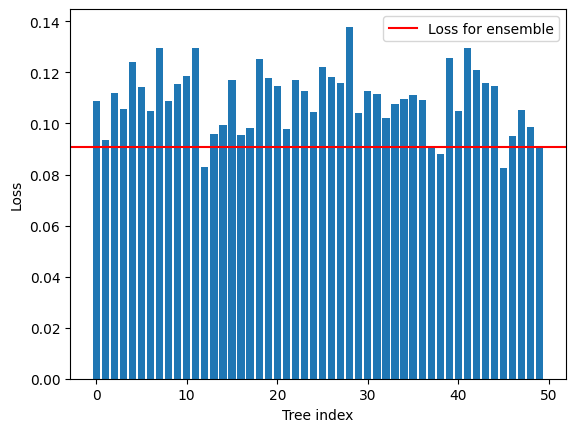

In [108]:
np.random.seed(300)

ens_loss, ind_losses = accuracyEnsemble2(1000, 50)
x_axis = np.arange(0,50)
plt.bar(x_axis, ind_losses)
plt.axhline(y=ens_loss, label = 'Loss for ensemble', color ="r")
plt.ylabel('Loss')
plt.xlabel('Tree index')
plt.legend()
plt.show()

# Task 2b - Ensemble and decision trees (18 marks)

* Present and briefly discuss your results on the test set. (2 marks)

# Task 2c - Ensemble and decision trees (18 marks)

* Show the relationship between the error rate of the ensemble, the error rate of the individual base models, and the number of base moedels. Does ensembling improve performance? (7 marks)

In [109]:
import time
np.random.seed(8)


num_trees = 100
ensemble_errors = []

for i in range(1,num_trees+1):
    accuracy = accuracyEnsemble(2000, i)
    error = accuracy
    ensemble_errors.append(error)

plt.figure(figsize=(10,6))
plt.plot(np.arange(1,num_trees+1, 1), ensemble_errors, label='Ensemble Accuracy')



start_time = time.time()

timing_40 = accuracyEnsemble(2000, 40)
end_time = time.time()

print("time for 40", end_time - start_time)

np.random.seed(8)

start_time = time.time()

error_for1 =accuracyEnsemble(2000,1)

end_time = time.time()

print("time for 1", end_time - start_time)

print(error_for1)
print(np.max(np.array(ensemble_errors)))
print(np.mean(np.array(ensemble_errors)))
plt.axhline(y=error_for1, label = 'Accuracy for 1 Tree', color ="r")

plt.xlabel('Number of Trees in Ensemble')
plt.ylabel('Accuracy')
plt.title('How number of trees in ensemble affects accuracy')
plt.legend(loc = 'center right')
plt.savefig('ensemble_comparison.png')
# plt.grid(True)
plt.show()


KeyboardInterrupt: 

# Task 2d - Ensemble and decision trees (18 marks)

* How sensitive is the model to different hyperparameters (e.g. maximum tree depth)> USe plots to explore the different trade-offs. (7 marks)

In [ ]:
def ensembleTree2(sample_size, num_models, md, mss, msl, c):
    all_models = []
    for m in range(num_models):
        sample_idx = np.random.choice(X_tr.shape[0], sample_size)
        X_train_sample, y_train_sample = X_tr[sample_idx], y_tr[sample_idx]
        
        model = DecisionTreeClassifier(max_depth = md, min_samples_split =mss, min_samples_leaf = msl, criterion=c)
        
        model.fit(X_train_sample,y_train_sample)
        
        all_models.append(model)
    return all_models

# ensembleTree(2, 10)

In [ ]:
def accuracyEnsemble2(sampleSize, numModels, md, mss, msl, c):
    all_models = ensembleTree2(sampleSize, numModels, md, mss, msl, c)
    prediction = bagging_predict(X_test, all_models)
    accuracy = np.count_nonzero(prediction==(y_test))/y_test.shape[0]
    return accuracy

In [ ]:
import time

none_array = np.array([None])

max_depths = np.arange(1, 50, 1)
min_samples_split = np.arange(2,50,1)
min_samples_leaf = np.arange(2,50,1)
criterion = ['gini' , 'entropy']

max_depths = np.concatenate((none_array,max_depths))

# min_samples_split= np.concatenate((none_array,min_samples_split))

# min_samples_leaf= np.concatenate((none_array,min_samples_leaf))

parameters = [max_depths, min_samples_split, min_samples_leaf]

x_labels = ['max depth','min samples split','min samples leaf']

all_errors = []

print("doing depths")

np.random.seed(1)

all_times = []

times_md =[]

errors_md=[]
for md in range(len(max_depths)):
    # np.random.seed(8)
    start_time = time.time()
    loss = accuracyEnsemble2(2000, 20, max_depths[md], 2, 1, 'gini')
    errors_md.append(loss)
    end_time = time.time()
    times_md.append(end_time - start_time)

all_errors.append(errors_md)

all_times.append(times_md)

print("doing min samples split")

errors_mss=[]
times_mss = []
for mss in range(len(min_samples_split)):
    
    start_time = time.time()
    # np.random.seed(8)
    loss = accuracyEnsemble2(2000, 20, None, min_samples_split[mss], 1, 'gini')
    errors_mss.append(loss)
    end_time = time.time()
    
    times_mss.append(end_time - start_time)

all_errors.append(errors_mss)
all_times.append(times_mss)

print("doing min samples leaf")
errors_msl=[]
times_msl = []
for msl in range(len(min_samples_leaf)):
    start_time = time.time()
    # np.random.seed(8)
    loss = accuracyEnsemble2(2000, 20, None, 2, min_samples_leaf[msl], 'gini')
    errors_msl.append(loss)
    end_time = time.time()
    times_msl.append(end_time - start_time)

all_errors.append(errors_msl)

all_times.append(times_msl)

fig, axes = plt.subplots( 1, len(all_errors), figsize = (16, 5))

for i in range(len(all_errors)):
    ax = axes[i]
    ax.plot(parameters[i], all_errors[i])
    x = np.array(parameters[i][1:]).astype(float)
    z = np.polyfit(x, np.array(all_errors[i][1:]).astype(float), 1)
    y_hat = np.poly1d(z)

    ax.plot(x, y_hat(x), "r--", lw=1)
    ax.set_title(f'Subplot {x_labels[i]}')
    ax.set_xlabel(f'{x_labels[i]}')
    ax.set_ylabel('Accuracy')
    ax.set_ylim(0.86, 0.94)

plt.savefig("tree_hyperparameters.png")
plt.tight_layout()
plt.show()

fig, axes = plt.subplots( 1, len(all_errors), figsize = (16, 5))

for i in range(len(all_times)):
    ax = axes[i]
    ax.plot(parameters[i], all_times[i])
    x = np.array(parameters[i][1:]).astype(float)
    z = np.polyfit(x, np.array(all_times[i][1:]).astype(float), 1)
    y_hat = np.poly1d(z)

    ax.plot(x, y_hat(x), "r--", lw=1)
    ax.set_title(f'Subplot Times {x_labels[i]}')
    ax.set_xlabel(f'{x_labels[i]}')
    ax.set_ylabel('Time (s)')
    ax.set_ylim(0.075, 0.15)

plt.savefig("tree_hyperparameters_times.png")
plt.tight_layout()
plt.show()

    


# Task 3 - Sequence Labelling (20 Marks)

* a) Train a sequence labeller (3 Marks) 

In [110]:
from hmmlearn import hmm
from IPython import display


import nltk
from nltk.corpus import brown
from nltk.probability import ConditionalFreqDist,ConditionalProbDist,MLEProbDist
import itertools

import ipywidgets as widgets

In [114]:
def plot_hmm(model, states, observations, i):
    """Plots HMM states and observations for 1d states and observations.

    Args:
    model (hmmlearn model):               hmmlearn model used to get state means.
    states (numpy array of floats):       Samples of the states.
    observations (numpy array of floats): Samples of the states.
    """

    nsteps = states.size
    fig, ax1 = plt.subplots(figsize=(12,4))
    
    # ax1.step(np.arange(nstep), y_test, "--", where="mid", alpha=1.0, c="red", label = "States")
    ax1.step(np.arange(nstep), states, "--", where="mid", alpha=1.0, c="green", label = "States")
    # ax1.step(np.arange(nstep), states_forplot, "--", where="mid", alpha=1.0, c="green")
    ax1.set_xlabel("Time")
    ax1.set_ylabel("State", c="green")
    ax1.set_ylim(-1,4)
    # ax1.set_yticks([-1, 1])
    # ax1.set_yticklabels(["State 1", "State 0"])

    ax2 = ax1.twinx()
    observation_mean = np.mean(observations, axis = 1)
    ax2.plot(np.arange(nstep), observations[:,i], c="blue", label =  "Observations")
    ax2.set_ylabel("Observations", c="blue")
    # ax1.set_ylim(ax2.get_ylim())
    plt.title(f'States and Observations of GaussianHMM for {input_cols[i]}')
    plt.savefig(f'gaussianhmm{i}.png')
    plt.show(fig)

In [115]:
##CORRECT ANSWER##
def hmm_model():
    n_components = 4
    model = hmm.GaussianHMM(n_components=n_components, covariance_type="full", n_iter =5)
    
    model.fit(X_tr)
    model.means_ = means

    covariance_matrices = [np.diag(diag_covar) for diag_covar in diagonal_covars]
    model.covars_ = covariance_matrices
    counter = 0
    
    if model.monitor_.converged:
        print("Model Converged")
    
    return model
##CORRECT ANSWER#

Model Converged
accuracy:  0.9290863809149299


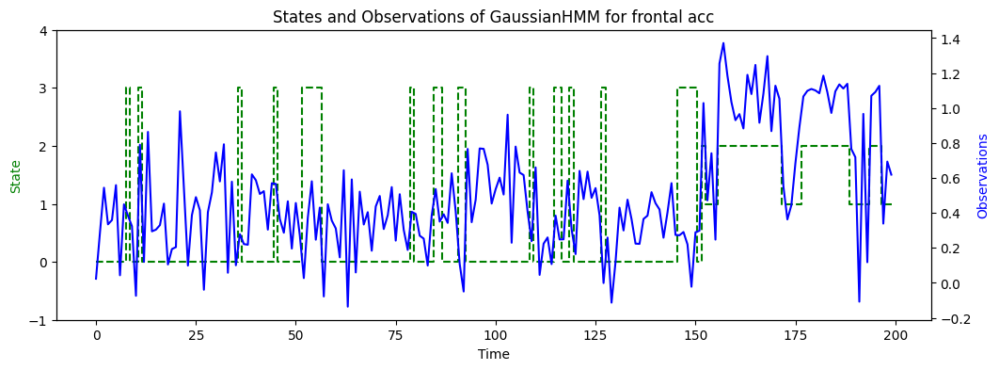

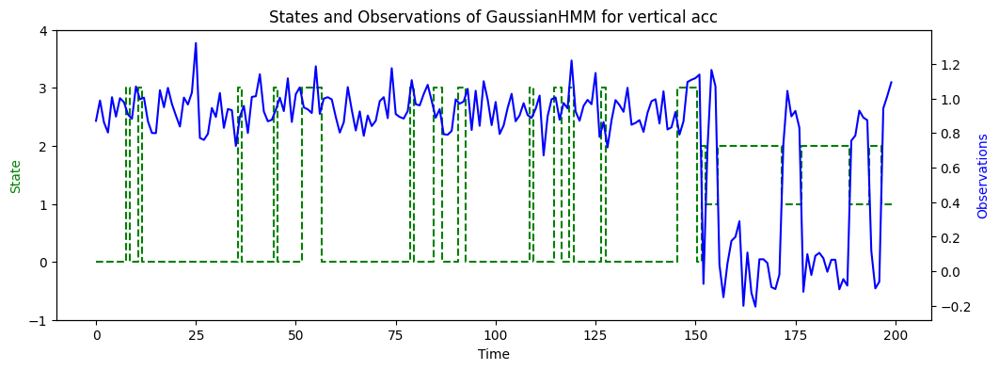

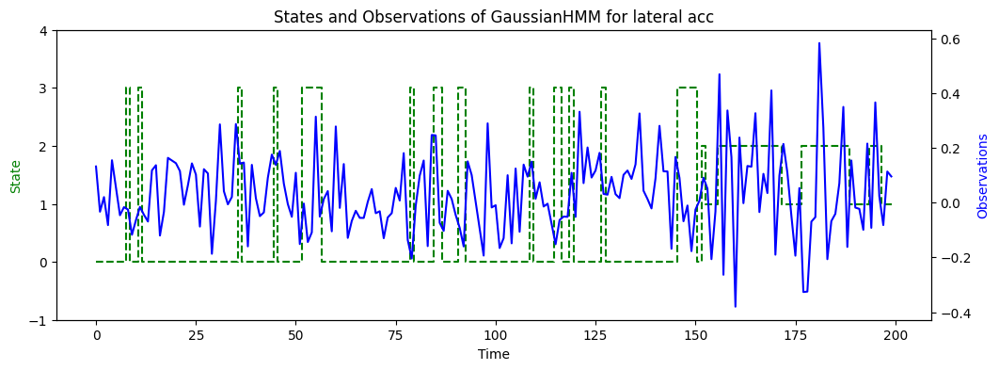

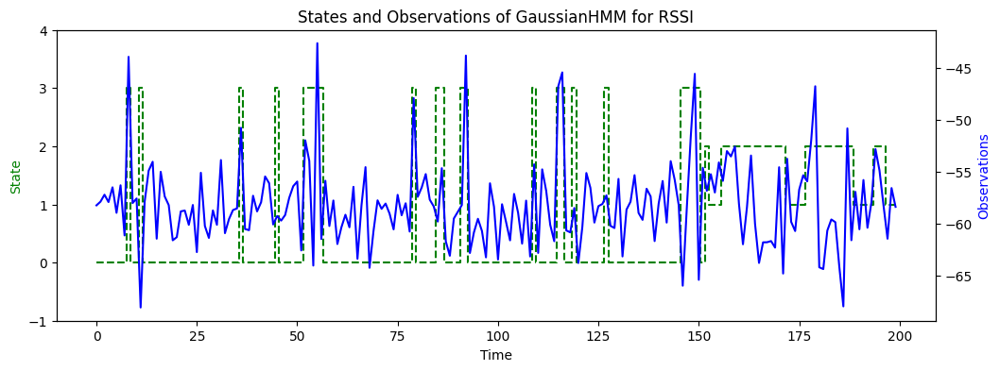

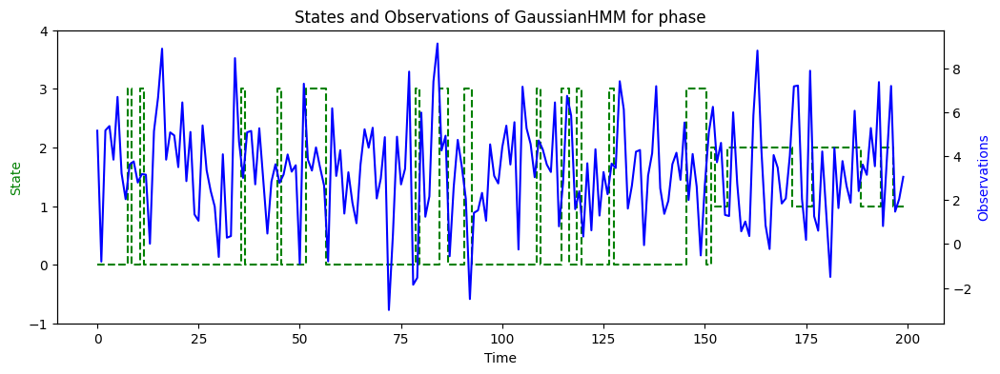

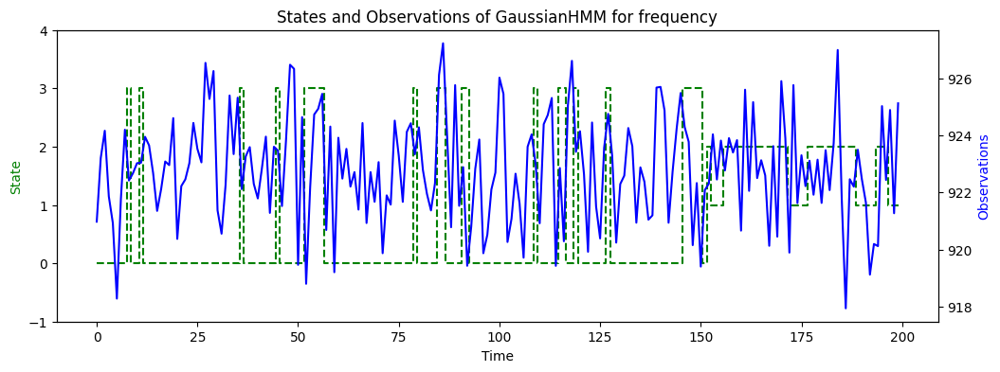

In [116]:
np.random.seed(42)

# print(output_classes)
nstep = 200
model = hmm_model()

hidden_states = model.predict(X_test)
    
accuracy = accuracy_score(hidden_states,y_test)
print("accuracy: ", accuracy)

observations, states = model.sample(nstep)

for i in range(observations.shape[1]):
    plot_hmm(model, states, observations, i)


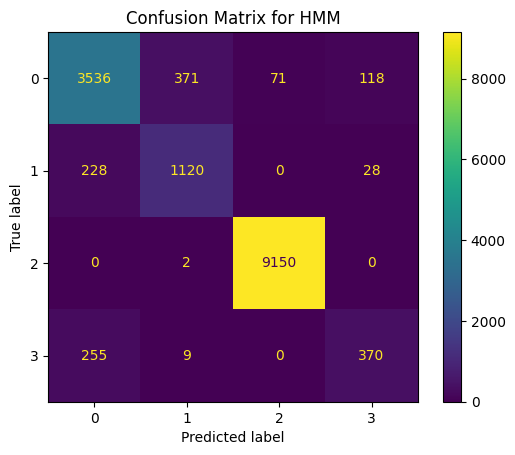

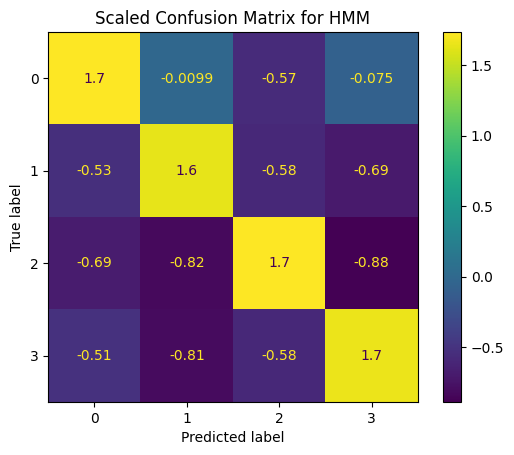

In [117]:
cm = confusion_matrix(y_test, hidden_states)
cm_scaled = scaler.fit_transform(cm)
# Plot using ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp_scale = ConfusionMatrixDisplay(confusion_matrix=cm_scaled)
disp.plot().ax_.set_title("Confusion Matrix for HMM")  # You can choose your color map

disp_scale.plot().ax_.set_title("Scaled Confusion Matrix for HMM")  # You can choose your color map
plt.show()

# Task 3 - Sequence Labelling (20 Marks)

* b) Plot a transition matrix and explain what the matrix tells us about the relationships between different activities (6 marks)

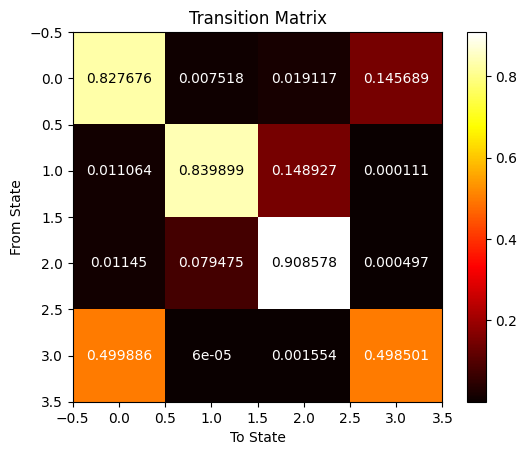

In [118]:
plt.imshow(model.transmat_, cmap='hot', interpolation='nearest')
plt.colorbar()

plt.xlabel('To State')
plt.ylabel('From State')
plt.title('Transition Matrix')

for i in range(model.transmat_.shape[0]):
    for j in range(model.transmat_.shape[1]):
        if model.transmat_[i,j] > 0.5:
            color = "black"
        else:
            color = "w"
        text = plt.text(j, i, np.round(model.transmat_[i, j], 6),
                       ha="center", va="center", color=color)

plt.show()

# Task 3 - Sequence Labelling (20 Marks)

* c) Identify any features that are particularly informative when predicting activity labels? Justify your answer e.g. by comparing the means of the emission distributions

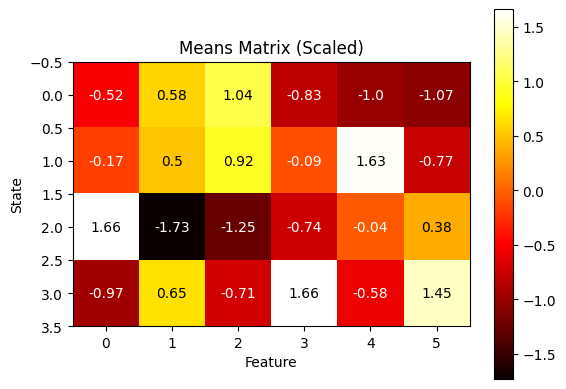

In [119]:

plt.ylabel('State')
plt.xlabel('Feature')
plt.title('Means Matrix (Scaled)')


scaler = StandardScaler()
scaled_means = scaler.fit_transform(model.means_)
mean_all = np.mean(scaled_means)

plt.imshow(scaled_means, cmap='hot', interpolation='nearest')
plt.colorbar()


for i in range(scaled_means.shape[0]):
    for j in range(scaled_means.shape[1]):
        if scaled_means[i,j] > mean_all:
            color = "black"
        else:
            color = "w"
        text = plt.text(j, i, np.round(scaled_means[i, j], 2),
                       ha="center", va="center", color=color)

plt.show()

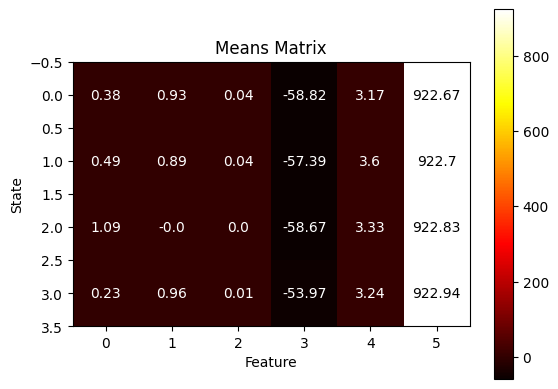

In [120]:

plt.ylabel('State')
plt.xlabel('Feature')
plt.title('Means Matrix')


scaler = StandardScaler()
scaled_means = model.means_
mean_all = np.mean(scaled_means)

plt.imshow(scaled_means, cmap='hot', interpolation='nearest')
plt.colorbar()


for i in range(scaled_means.shape[0]):
    for j in range(scaled_means.shape[1]):
        if scaled_means[i,j] > mean_all:
            color = "black"
        else:
            color = "w"
        text = plt.text(j, i, np.round(scaled_means[i, j], 2),
                       ha="center", va="center", color=color)

plt.show()

* Low feature 4 gets state 1
* high feature 1 gets state 2 
* low Feature 0  gets state 2
* high feature 3 gets state 3???
* low feature 3 gets state 0???
* low feature 1 gets state 3???

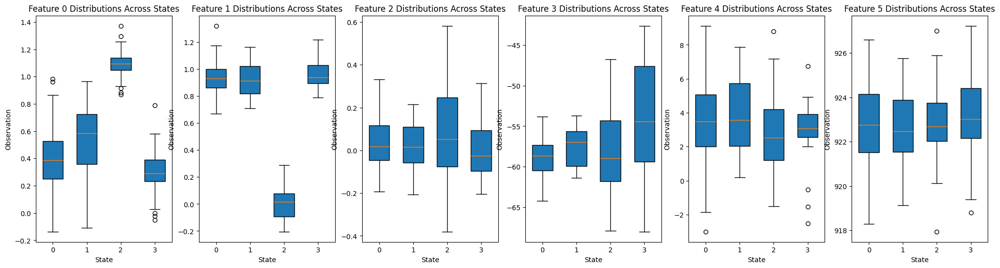

In [121]:
import seaborn as sns



state_colors = ["blue","green","red","yellow"]

diff_states = np.unique(states)

fig, axes = plt.subplots(1,6, figsize=(25,6))

for f in range(observations.shape[1]):
    to_plot = []
    positions = np.arange(len(diff_states))
    # plt.figure(figsize=(2, 6))
    
    for i in range(len(diff_states)):
        state_data = observations[states == diff_states[i], f]
        to_plot.append(state_data)
        # sns.boxplot(data=observations[states == diff_states[i], f], color=state_colors[i], positions = [i])
    axes[f].boxplot(to_plot, positions=positions, widths=0.6, patch_artist=True)
    axes[f].set_xlabel("State")
    axes[f].set_ylabel("Observation")

    # sns.boxplot(positions=np.arange(observations.shape[1]))
    axes[f].set_title(f'Feature {f} Distributions Across States')
plt.show()
# plt.legend()

# Task 3 - Sequence Labelling (20 Marks)

* d) Compare your sequence labeller with the neural network and decision tree ensemble, considering performance, training time, and interpretability. What are the strengths and weaknesses of each approach? You may use both plots and discussion in your comparison. (7 Marks)

In [35]:
import time

start_time = time.time()
for i in range(100):
    model = hmm_model()
end_time = time.time()

print("hmm trained!")

total_time = end_time - start_time
hmm_time = total_time / 100

start_time = time.time()
for i in range(100):
    all_models = ensembleTree(1000, 100)
end_time = time.time()

print("ensemble trained!")

total_time = end_time - start_time
ensemble_time = total_time / 100

start_time = time.time()
for i in range(5):
    print(i)
    model = mlp_train()
end_time = time.time()

print("mlp trained")

total_time = end_time - start_time
mlp_time = total_time / 5




0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Converged
0
Model Co

In [122]:

times = [hmm_time, ensemble_time, mlp_time]
print(times)
models = ['Hidden Markov Model', 'Decision Tree Ensemble', 'Neural Network Classfier']
colors = ['r','g','b']

# plt.figsize(6,10)
plt.figure(figsize=(10,6))
plt.bar(models, times, color=colors)

plt.xlabel('Model')
plt.ylabel('Mean Training Time (seconds)')
plt.title('Model Training Time Comparison')
plt.show()

NameError: name 'hmm_time' is not defined

# Task 4 - Clustering and dimensionality reduction
* Use PCA to reduce data from 30-dimensions to 2. Produce a scatter plot of this 2-D data using colours to indicate the class label of each data point. Also, explain how much variance is explained by the first principal component and how much is explained by the second. (5 Marks)

In [57]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import KernelPCA, PCA
from sklearn.decomposition import FastICA
import pandas as pd

In [58]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

data = pd.read_csv('./breast+cancer+wisconsin+diagnostic/wdbc.data', header=None)

# Selecting the features (assuming they are from the 3rd to the last column)
features = data.iloc[:, 2:]
ids = data.iloc[:,:2]

# Standardizing the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Applying PCA to reduce to 2 components
pca = PCA(n_components=2)
principal_components = pca.fit_transform(features_scaled)

explained_variances = pca.explained_variance_ratio_
print(f"Variance first principal component: {explained_variances[0] * 100:.2f}%")
print(f"Variance second principal component: {explained_variances[1] * 100:.2f}%")


# Creating a DataFrame with the 2 principal components
pca_df = pd.DataFrame(data=principal_components, columns=['Principal Component 1', 'Principal Component 2'])



Variance first principal component: 44.27%
Variance second principal component: 18.97%


In [59]:
import warnings
warnings.filterwarnings('ignore')
# print(data)
sns.pairplot(pca_df, hue=data.columns[1])

NameError: name 'sns' is not defined

['B' 'M']
['B' 'M']
{'B': 'blue', 'M': 'red'}
[13.30499079  5.7013746 ]


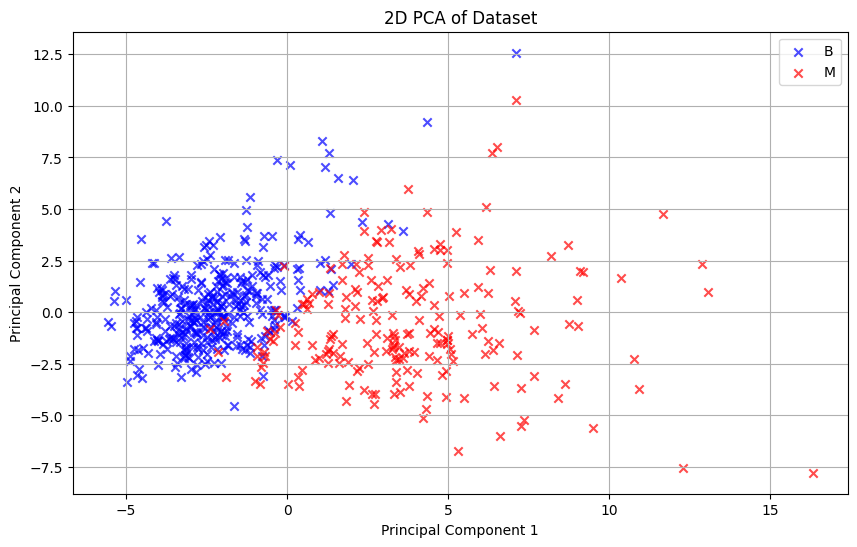

In [60]:
class_labels = data.iloc[:,1]
unique_labels = np.unique(class_labels)
print(unique_labels)
colors = {label: color for label, color in zip(unique_labels, ['blue', 'red'])}

print(unique_labels)
print(colors)
# Creating the scatter plot
plt.figure(figsize=(10, 6))
for label in unique_labels:
    idx_to_plot = class_labels == label
    plt.scatter(principal_components[idx_to_plot, 0], 
                principal_components[idx_to_plot, 1], 
                label=label, 
                alpha=0.7, 
                color=colors[label],
               marker = "x")
print(pca.explained_variance_)

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2D PCA of Dataset')
plt.legend()
plt.grid(True)
plt.show()

# Task 5 - Gaussian Mixture Models
* Fit a Gaussian Mixture model with 2 components using the 2-dimensional data and display the soft clusters using a scatter plot. The colour of each point should represent the responsibilities associated with that point - so there will be more than 2 colours in your scatter plot (5 Marks)

In [61]:
from sklearn.mixture import GaussianMixture
import matplotlib.cm as cm

# Fit a Gaussian Mixture Model with 2 components
gmm = GaussianMixture(n_components=2)
gmm.fit(principal_components)

# Obtain responsibilities (probabilities of belonging to each cluster)
responsibilities = gmm.predict_proba(principal_components)



[[2.63333630e-15 1.00000000e+00]
 [1.83187297e-04 9.99816813e-01]
 [1.80229321e-08 9.99999982e-01]
 ...
 [5.98627668e-02 9.40137233e-01]
 [1.49090502e-18 1.00000000e+00]
 [9.66669642e-01 3.33303578e-02]]


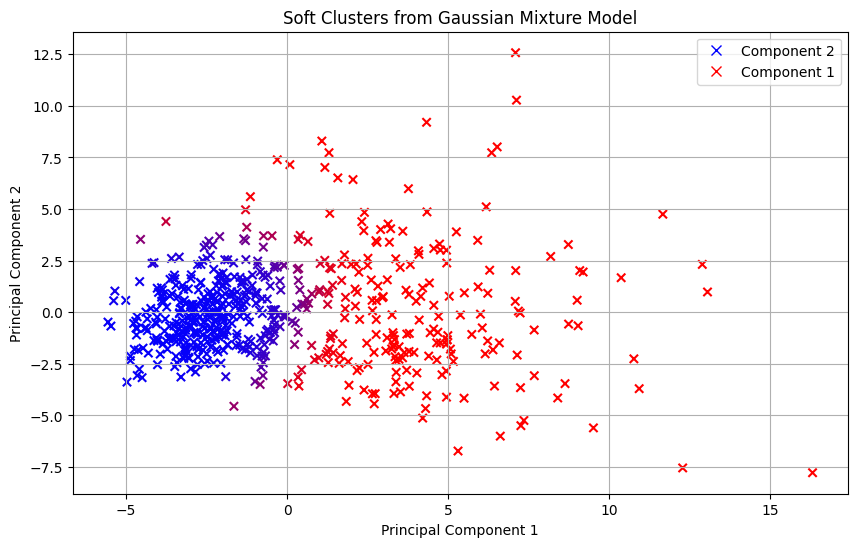

In [68]:
# Adjusting the responsibilities to use only the dominant cluster's probability for each point
# This is done by selecting the maximum responsibility value for each point
# dominant_responsibility = np.max(responsibilities, axis=1)
import matplotlib.lines as mlines

dominant_responsibility = []

for i in responsibilities:
    color = np.array([i[1], 0, i[0]])
    # if i[0] > i[1]:
    #     color = zip(color, "red")
    # else:
    #     color = zip(color, "blue")
    dominant_responsibility.append(color)

dominant_responsibility = np.array(dominant_responsibility)



print(responsibilities)

# Creating the scatter plot with colors representing the dominant responsibilities
plt.figure(figsize=(10, 6))

scatter = plt.scatter(principal_components[:, 0], principal_components[:, 1], 
                      c=dominant_responsibility,  marker ='x')

blue = mlines.Line2D([], [], color='blue', marker='x', linestyle='None',
                          markersize=7, label='Component 2')
red = mlines.Line2D([], [], color='red', marker='x', linestyle='None',
                          markersize=7, label='Component 1')


plt.title('Soft Clusters from Gaussian Mixture Model')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(handles = [blue,red])
plt.grid(True)
plt.show()


# Task 6

* You now have 2 different sorts of coloured scatter plot. Identify the main differences between them and explain these differences. (5 Marks)


# PCA Scatter Plot* 
Purpose: This plot was designed to show how well the PCA process separated different classes in the dataset in the reduced 2D space. It was a visualization tool to understand the inherent clustering in the data.* 
Color Scheme: The colors indicated the actual class labels of the data points. The plot was binary in color since it represented two distinct classes* .
Interpretation: The separation or overlap of colors indicated how distinct or mixed the classes were in the PCA-reduced spac# e.
GMM Scatter P* lot
Purpose: This plot visualized the soft clustering results from the Gaussian Mixture Model. It was meant to show how the GMM algorithm probabilistically assigned data points to one of two clust* ers.
Color Scheme: The colors represented the probability (responsibility) of each data point belonging to the most likely cluster. The plot used a gradient color scheme, with points showing a mixture of colors where the model had uncertainty.
Interpretation: Points with similar colors were more likely to belong to the same cluster. Points with mixed colors indicated areas where the model was uncertain about the clust# ering.
Key Diff* erences
Class Labels vs. Cluster Assignments: The PCA plot used actual class labels, while the GMM plot used cluster assignments from th* e model.
Binary vs. Gradient Color Representation: The PCA plot had a clear binary color distinction representing two different classes. In contrast, the GMM plot used a gradient to represent a range of probabilities, indicating a soft clustering * approach.
Interpretability: The PCA plot was directly interpretable in terms of actual data classes. The GMM plot, however, required interpretation of probabilities and did not directly relate to the original class labels.


# Task 7 - Classification with SVMS (10 Marks)
* Use an SVM approach to learn a classifier from the first 450 datapoints of the Breast Cancer Wisconsin (Diagnostic) dataset and report 
its accuracy on the the last 118 datapoints (i.e. use these 118 datapoints as a test set). Attempt to maximise the test set accuracy b 
choosing an appropriate kernel and appropriate degree of regularisation. Feel free to score candidate SVM predictors on the test set to s e
what works best (so the test set is really acting as a validation set,  ot
a test set in the strict sense). (4 marks)

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.svm import SVC
from sklearn.datasets import make_moons
from sklearn.metrics import accuracy_score
import seaborn as sns

import h5py
import imageio
from PIL import Image 

In [15]:
# train_X_bc = features[:450]
# test_X_bc = features[450:]
# train_y_bc = ids[:450]
# test_y_bc = ids[450:]
X = data.iloc[:, 2:]
y = data.iloc[:, 1]

train_data = data.iloc[:450]
test_data = data.iloc[450:]

scaler= StandardScaler()

X_train_bc = train_data.iloc[:, 2:]
X_train_bc = scaler.fit_transform(X_train_bc)
y_train_bc = train_data.iloc[:, 1]

X_test_bc = test_data.iloc[:, 2:]
X_test_bc = scaler.fit_transform(X_test_bc)
y_test_bc = test_data.iloc[:, 1]



In [103]:
import warnings
warnings.filterwarnings('ignore')
# print(data)
sns.pairplot(data, hue=data.columns[1])

In [107]:
print(X_train_bc.shape)

(450, 30)


In [54]:
import pandas as pd
svm = SVC()

np.random.seed(8)

param_grid = {
    'C': [0.001,0.01, 0.1, 1, 5, 10, 50,100], 
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto', 0.1, 1, 10, 100]
}

# Grid search with cross-validation
grid_search = GridSearchCV(svm, param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Perform the grid search
grid_search.fit(X_train_bc, y_train_bc)

# Best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_
results = pd.DataFrame(grid_search.cv_results_)

print("Best Parameters:", best_params)
print("Best Score:", best_score)

best_model = SVC(**best_params)
best_model.fit(X_train_bc, y_train_bc)
predictions = best_model.predict(X_test_bc)
print("accuracy: ",accuracy_score(predictions, y_test_bc))

svm.fit(X_train_bc, y_train_bc)
print(f'SVM classifier accuracy: {svm.score(X_test_bc, y_test_bc)}')


Best Parameters: {'C': 0.01, 'gamma': 'scale', 'kernel': 'linear'}
Best Score: 0.9733333333333334
accuracy:  0.9663865546218487
SVM classifier accuracy: 0.9243697478991597


In [113]:
import time
start_time = time.time()
for i in range(100):
    svm = SVC(**best_params)
    svm.fit(X_train_bc, y_train_bc)

end_time = time.time()
time = (end_time - start_time) / 100
print(time)

0.003331146240234375


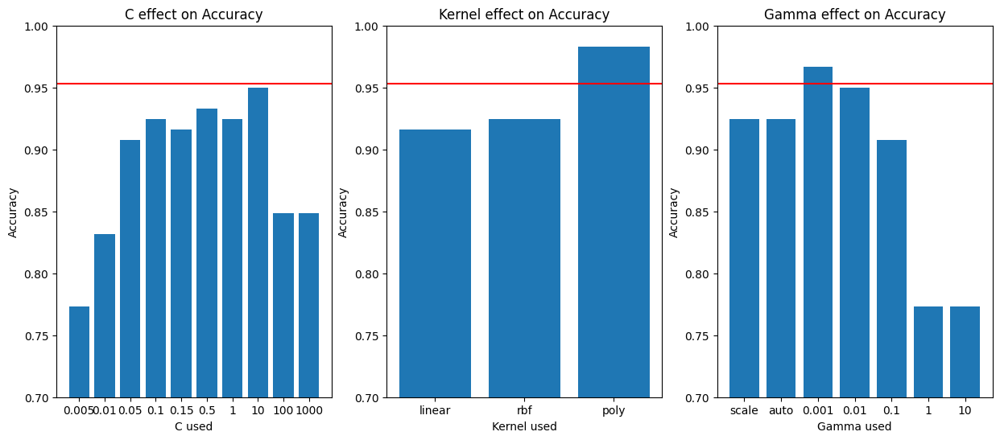

In [106]:
C = [0.005,0.01, 0.05, 0.1, 0.15, 0.5, 1, 10, 100, 1000]
kernel=['linear', 'rbf', 'poly']
gamma = ['scale', 'auto', 0.001, 0.01, 0.1, 1, 10]

fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize =(15,6))


np.random.seed(8)
c_acc = []

for c in C:
    svm =SVC(C=c)
    svm.fit(X_train_bc, y_train_bc)
    predictions = svm.predict(X_test_bc)
    accuracy = accuracy_score(predictions, y_test_bc)
    c_acc.append(accuracy)

C = [str(x) for x in C]

ax1.bar(C, c_acc)
ax1.axhline(best_score, color = 'r')
ax1.set_xlabel('C used')
ax1.set_ylabel('Accuracy')
ax1.set_title('C effect on Accuracy')
ax1.set_ylim(0.7,1)


np.random.seed(8)
k_acc =[]

for k in kernel:
    svm =SVC(kernel=k)
    svm.fit(X_train_bc, y_train_bc)
    predictions = svm.predict(X_test_bc)
    accuracy = accuracy_score(predictions, y_test_bc)
    k_acc.append(accuracy)

# print(k_acc[2])

ax2.bar(kernel, k_acc)

ax2.axhline(best_score, color = 'r')
ax2.set_xlabel('Kernel used')
ax2.set_ylabel('Accuracy')
ax2.set_title('Kernel effect on Accuracy')
ax2.set_ylim(0.7,1)


np.random.seed(8)
g_acc =[]

for g in gamma:
    svm =SVC(gamma = g)
    svm.fit(X_train_bc, y_train_bc)
    predictions = svm.predict(X_test_bc)
    accuracy = accuracy_score(predictions, y_test_bc)
    g_acc.append(accuracy)

gamma = [str(x) for x in gamma]

ax3.bar(gamma, g_acc)

ax3.axhline(best_score, color = 'r')
ax3.set_xlabel('Gamma used')
ax3.set_ylabel('Accuracy')
ax3.set_title('Gamma effect on Accuracy')
ax3.set_ylim(0.7,1)
plt.show()
    

# Task 8 - Classification with SVMs (10 Marks)
* Repeat the previous task but now use the 2-dimensional dataset 
(plus class labels) produced earlier via PCA. (4 marks)

# Task 9 - classification with SVMs
* Discuss to what extent, if any, using the 2-dimensional approximation to the original data affected test set accuracy. (2 marks)

In [66]:
param_grid = {
    'C': [0.01, 0.1, 1, 5, 10, 50,100], 
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto', 0.1, 1, 10]
}

X_train_pca = principal_components[:450]
X_test_pca = principal_components[450:]

scaler = StandardScaler()
X_train_pca_fitted = scaler.fit_transform(X_train_pca)

svm = SVC()

grid_search = GridSearchCV(svm, param_grid, cv=5, scoring='accuracy', verbose = 3,n_jobs=-1)

# Perform the grid search
grid_search.fit(X_train_pca_fitted, y_train_bc)
print("done with grid search")

# Best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print(best_params, best_score)




Fitting 5 folds for each of 105 candidates, totalling 525 fits
done with grid search
{'C': 50, 'gamma': 0.1, 'kernel': 'rbf'} 0.9533333333333334


In [112]:
import time
start_time = time.time()
for i in range(100):
    svm = SVC(**best_params)
    svm.fit(X_train_pca_fitted, y_train_bc)

end_time = time.time()
time = (end_time - start_time) / 100
print(time)

0.0016963887214660645


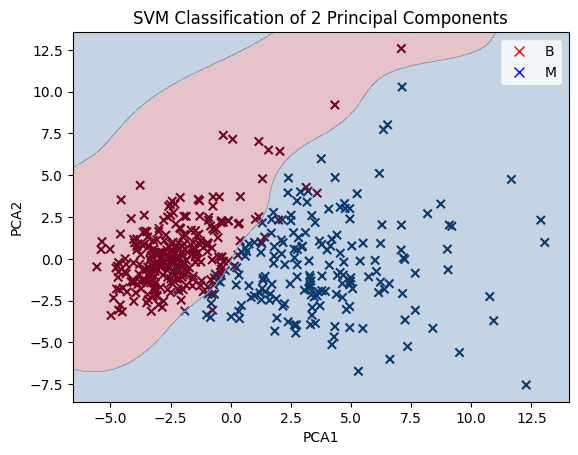

SVM classifier accuracy: 0.9663865546218487


In [94]:
y_train_ids=[1 if x =='M' else 0 for x in y_train_bc]
y_test_ids = [1 if x == 'M' else 0 for x in y_test_bc]

svm = SVC(**best_params)

svm.fit(X_train_pca, y_train_ids)

plt.scatter(X_train_pca[:,0], X_train_pca[:,1], marker='x', c=y_train_ids, cmap='RdBu')

h = .02  # step size in the mesh
x_min, x_max = X_train_pca[:, 0].min() - 1, X_train_pca[:, 0].max() + 1
y_min, y_max = X_train_pca[:, 1].min() - 1, X_train_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Plotting decision boundaries
Z = svm.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
plt.contourf(xx, yy, Z, alpha=0.25, cmap='RdBu')

# Adding labels and title
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.title('SVM Classification of 2 Principal Components')


blue = mlines.Line2D([], [], color='r', marker='x', linestyle='None',
                          markersize=7, label='B')
red = mlines.Line2D([], [], color='b', marker='x', linestyle='None',
                          markersize=7, label='M')

plt.legend(handles=[blue,red])

plt.show()
print(f'SVM classifier accuracy: {svm.score(X_test_pca, y_test_ids)}')

improves test set accuracy and reduces runtime

# Task 10 - Bayesian Linear Regression

Download data... and deal with non numeric columns

In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import KernelPCA, PCA
from sklearn.decomposition import FastICA


df = pd.read_csv("./seoul+bike+sharing+demand/SeoulBikeData.csv", encoding='ISO-8859-1')
#standardise numerical data

scaler = StandardScaler()
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
numeric_columns = numeric_columns.drop('Rented Bike Count')  # Exclude the target variable
numeric_columns = numeric_columns.drop('Hour')

df[numeric_columns] = scaler.fit_transform(df[numeric_columns])

# #Yes = 0, No = 1
df['Functioning_day_id'] = pd.factorize(df['Functioning Day'])[0]

df = df.drop('Seasons', axis =1)
df = df.drop('Holiday', axis =1)
df = df.drop('Functioning Day', axis =1)
df = df.drop('Date', axis = 1)


* It is clearly not possible to do linear regression without altering the downloaded data in some way (for example, a number of variables are not numeric). Bearing in mind that the goal is to predict number of bikes rented, create a new dataset from the original downloaded dataset that is suitable for Bayesian Linear Regression (BLR). In your report, describe and justify how you have transformed the data. (8 marks)

In [69]:
df_sorted = df.sort_values(by='Rented Bike Count', ascending = False)

# print(np.std(df['Rented Bike Count']))

df_sorted.head(20)
# df.head()
# numeric_columns_scaled.head()
# df.head(40)

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm)
4818,3556,18,24.1,57,2.9,1301,15.0,0.56,0.0,0.0
4866,3418,18,27.8,43,3.0,1933,14.0,1.35,0.0,0.0
4650,3404,18,24.9,53,3.6,2000,14.6,1.28,0.0,0.0
4842,3384,18,27.0,55,3.1,1246,17.1,1.26,0.0,0.0
4458,3380,18,24.4,48,1.9,1998,12.6,0.56,0.0,0.0
4890,3365,18,29.3,27,3.4,1977,8.3,1.24,0.0,0.0
4554,3309,18,26.2,54,2.2,1183,16.1,0.88,0.0,0.0
6810,3298,18,25.9,42,1.1,2000,11.9,0.48,0.0,0.0
6978,3277,18,25.3,56,2.8,1992,15.8,0.54,0.0,0.0
6858,3256,18,27.0,44,1.4,2000,13.6,0.62,0.0,0.0


In [57]:
# train_sbsd = df[:7200]
# test_sbsd = df[7200:]
from sklearn.model_selection import train_test_split

# scaler = StandardScaler()

X_sbsd = df.iloc[:,1:]
y_sbsd = df.iloc[:,0]

# # X_sbsd_fitted = scaler.fit_transform(X_sbsd)
# X_train_sbsd, X_test_sbsd, y_train_sbsd, y_test_sbsd = train_test_split(X_sbsd, y_sbsd, test_size=0.2, random_state=8)


# X_train_sbsd.head()

In [65]:
import pytensor.tensor as at
import pymc as pm
import arviz as az

model = pm.Model()

# print(X_train_sbsd)

num_samples = 1000
with model:
    # Defining our priors
    w0 = pm.Normal('Intercept', mu=0, sigma=20) # intercept
    w1 = pm.Normal('Hour', mu = 0, sigma =20)
    w2 = pm.Normal('Temperature', mu = 0, sigma = 25) #temperature
    w3 = pm.Normal('Humidity', mu = 0, sigma = 25) # humidity
    w4 = pm.Normal('Wind speed', mu = 0, sigma = 25) # wind speed
    w5 = pm.Normal('Visibility', mu =0, sigma = 75) # visibility
    w6 = pm.Normal('Dew point temperature', mu = 0, sigma = 100) # dew point temperature
    w7 = pm.Normal('Solar Radiation', mu =0, sigma = 75) #solar Radiation
    w8 = pm.Normal('Rainfall', mu =0 ,sigma = 25) #rainfall
    w9 = pm.Normal('Snowfall',mu =0 ,sigma = 25) # snowfall
    sigma = pm.Uniform('sigma', lower =0, upper = 200)
    
    ws = [w1,w2, w3, w4, w5, w6, w7, w8, w9]
    ids = ['Hour', 'Temperature(°C)', 'Humidity(%)', 'Wind speed (m/s)', 'Visibility (10m)',
         'Dew point temperature(°C)', 'Solar Radiation (MJ/m2)', 'Rainfall(mm)',
         'Snowfall (cm)']

    y_est = w0 + pm.math.dot(ws, X_sbsd[ids].T)
    # y_est = w0 + pm.math.dot(X_train_sbsd,w1) # auxiliary variables
    likelihood = pm.Normal('y', mu=y_est, sigma=sigma, observed=y_sbsd)
    
    # inference
    sampler = pm.NUTS() # Hamiltonian MCMC with No U-Turn Sampler 
    # or alternatively
    # sampler = pm.Metropolis()
    
    idata = pm.sample(num_samples, step=sampler, progressbar=True, cores=2, chains=2)

Multiprocess sampling (2 chains in 2 jobs)
NUTS: [Intercept, Hour, Temperature, Humidity, Wind speed, Visibility, Dew point temperature, Solar Radiation, Rainfall, Snowfall, sigma]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 254 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


In [72]:
import pytensor.tensor as at
import pymc as pm
import arviz as az

df = pd.read_csv("./seoul+bike+sharing+demand/SeoulBikeData.csv", encoding='ISO-8859-1')
#standardise numerical data

df = df.drop('Seasons', axis =1)
df = df.drop('Holiday', axis =1)
df = df.drop('Functioning Day', axis =1)
df = df.drop('Date', axis = 1)

X_sbsd = df.iloc[:,1:]
y_sbsd = df.iloc[:,0]

model = pm.Model()

# print(X_train_sbsd)

num_samples = 1000
with model:
    # Defining our priors
    w0 = pm.Normal('Intercept', mu=0, sigma=50) # intercept
    w1 = pm.Normal('Hour', mu = 16, sigma =5)
    w2 = pm.Normal('Temperature', mu = 25, sigma = 10) #temperature
    w3 = pm.Normal('Humidity', mu = 50, sigma = 10) # humidity
    w4 = pm.Normal('Wind speed', mu = 2, sigma = 2) # wind speed
    w5 = pm.Normal('Visibility', mu = 1500, sigma = 600) # visibility
    w6 = pm.Normal('Dew point temperature', mu = 15, sigma = 30) # dew point temperature
    w7 = pm.Normal('Solar Radiation', mu =1, sigma = 1) #solar Radiation
    w8 = pm.Normal('Rainfall', mu =0 ,sigma = 5) #rainfall
    w9 = pm.Normal('Snowfall',mu =0 ,sigma = 5) # snowfall
    sigma = pm.Uniform('sigma', lower =0, upper = 1000)
    
    ws = [w1,w2, w3, w4, w5, w6, w7, w8, w9]
    ids = ['Hour', 'Temperature(°C)', 'Humidity(%)', 'Wind speed (m/s)', 'Visibility (10m)',
         'Dew point temperature(°C)', 'Solar Radiation (MJ/m2)', 'Rainfall(mm)',
         'Snowfall (cm)']

    y_est = w0 + pm.math.dot(ws, X_sbsd[ids].T)
    likelihood = pm.Normal('y', mu=y_est, sigma=sigma, observed=y_sbsd)
    
    # inference
    sampler = pm.NUTS() # Hamiltonian MCMC with No U-Turn Sampler 
    # or alternatively
    # sampler = pm.Metropolis()
    
    idata = pm.sample(num_samples, step=sampler, progressbar=True, cores=2, chains=2)

Multiprocess sampling (2 chains in 2 jobs)
NUTS: [Intercept, Hour, Temperature, Humidity, Wind speed, Visibility, Dew point temperature, Solar Radiation, Rainfall, Snowfall, sigma]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 474 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
Intercept,131.039,43.104,49.927,212.099,1.608,1.141,719.0,1112.0,1.01
Hour,28.042,0.773,26.577,29.434,0.017,0.012,2130.0,1401.0,1.00
Temperature,31.807,1.980,28.024,35.443,0.072,0.051,749.0,1132.0,1.01
Humidity,-4.072,0.500,-4.997,-3.125,0.020,0.014,648.0,1152.0,1.01
Wind speed,1.082,1.815,-2.417,4.370,0.038,0.036,2254.0,1389.0,1.00
Visibility,0.066,0.009,0.048,0.083,0.000,0.000,1991.0,1578.0,1.00
Dew point temperature,-3.477,2.065,-7.339,0.296,0.078,0.055,702.0,945.0,1.00
Solar Radiation,-0.218,0.991,-1.939,1.684,0.020,0.023,2451.0,1379.0,1.00
Rainfall,-33.369,3.389,-39.685,-27.100,0.064,0.046,2839.0,1364.0,1.00
Snowfall,1.054,4.589,-7.465,9.724,0.093,0.117,2470.0,1553.0,1.00


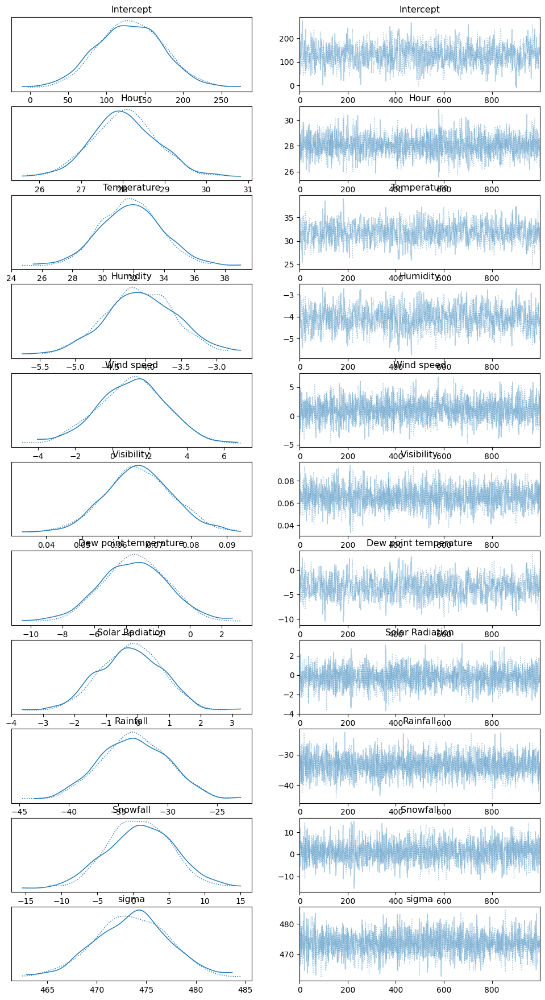

In [73]:
np.set_printoptions(precision=15)
pm.plot_trace(idata)
pm.summary(idata)


IndexError: too many indices for array: array is 2-dimensional, but 3 were indexed

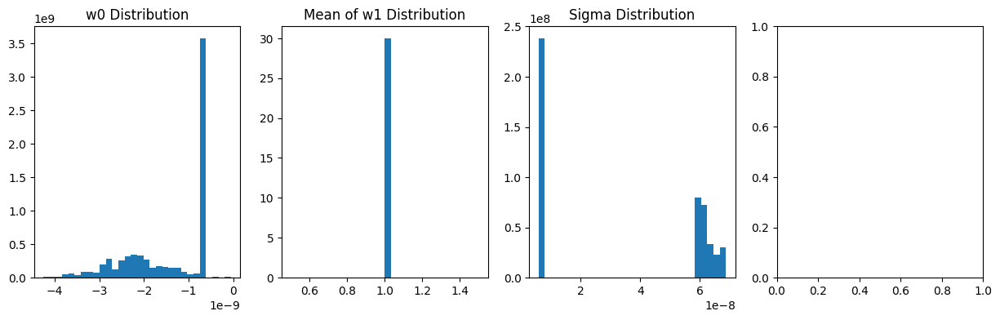

In [150]:

# Extracting the samples
w0_samples = idata.posterior['w0'].values.flatten()
w1_samples = idata.posterior['w1'].values
sigma_samples = idata.posterior['sigma'].values.flatten()

# Histogram of alpha
plt.figure(figsize=(15, 4))
plt.subplot(1, 4, 1)
plt.hist(w0_samples, bins=30, density=True)
plt.title('w0 Distribution')

# Histogram of mean of beta
plt.subplot(1, 4, 2)
mean_w1_samples = np.mean(w1_samples, axis=(0, 1))
plt.hist(mean_w1_samples, bins=30, density=True)
plt.title('Mean of w1 Distribution')

# Histogram of sigma
plt.subplot(1, 4, 3)
plt.hist(sigma_samples, bins=30, density=True)
plt.title('Sigma Distribution')

plt.subplot(1,4,4)
w1_sample = w1_samples[:, :, 0].flatten()
plt.hist2d(x=w0_samples, y=w1_sample, bins=25)
plt.xlabel('$w_0$')
plt.ylabel('$w_1$')
plt.show()

    

plt.tight_layout()
plt.show()

plt.figure(figsize= (15,12))
for i in range(1,13):
    plt.subplot(3, 4, i)
    # Histogram of beta i
    w1_sample = w1_samples[:, :, i-1].flatten()
    plt.hist(w1_sample, bins=30, density=True)
    plt.title(df.columns[i] + ' w1 Distribution')

plt.show()

plt.figure(figsize= (15,15))
for i in range(1,13):
    plt.subplot(3, 4, i)
    w1_sample = w1_samples[:, :, i-1].flatten()
    plt.hist2d(x=w0_samples, y=w1_sample, bins=25)
    plt.xlabel('$w_0$')
    plt.ylabel('$w_1$')
    plt.title(df.columns[i])

plt.show()
    

Histograms of alpha, beta, and sigma
Alpha (Intercept) Distribution:

This histogram shows the posterior distribution of the intercept term (alpha) in your regression model.
The central tendency (mean or median) indicates the typical value of the target variable when all predictors are at their average values.
The spread (variance) reflects the uncertainty around the intercept estimate.
Beta (Coefficients) Distributions:

Each beta coefficient corresponds to one predictor (feature) in your model.
The histograms of beta coefficients show how much and in what direction each predictor influences the target variable.
A beta histogram centered away from zero suggests a notable effect of that predictor on the target. The sign indicates the direction of the effect (positive or negative).
The width of the beta histograms indicates the uncertainty about these effects. Narrower distributions suggest more certainty.
Sigma (Noise) Distribution:

This represents the posterior distribution of the sigma parameter, which reflects the noise or error term in the model.
A narrower sigma distribution implies that the model is more certain about the level of noise in the data.
2D Histograms (Joint Distributions) of Alpha and Beta
These plots show the joint distribution of the intercept (alpha) and each predictor's coefficient (beta).
If you see patterns or shapes (like elongated shapes, distinct clusters, or circular patterns), they indicate correlations or dependency relationships between the intercept and the predictor coefficients.
A cloud-like, circular pattern with no clear direction suggests little to no correlation between alpha and the beta coefficient.
An elongated, angled shape indicates a correlation. The direction of the elongation can tell you about the nature of the correlation (positive or negative).

# Task 13 - Bayesian Linear Regression
* Comment, in your report, on whether you have evidence that the 
MCMC sampling has generated reasonable approximations to the posterior distributions of your parameters. (2 marks)


Gaining evidence that your sampling has generated reasonable estimates of the posterior distributions in a Bayesian model involves several diagnostic checks and analyses. These checks are crucial to ensure that the Markov Chain Monte Carlo (MCMC) sampling process has converged to the target distribution and that the samples drawn are representative of the posterior. Here are key methods to assess this:

1. **Trace Plots**: Examine trace plots of the sampled parameters. Trace plots show the sampled values at each step of the MCMC. You're looking for a "fuzzy caterpillar" appearance, indicating good mixing and stationary behavior. Large jumps, trends, or cyclic patterns may indicate problems.

2. **Autocorrelation Plots**: Check autocorrelation plots for the parameters. Ideally, you want low autocorrelation at all lags. High autocorrelation suggests that the chain is moving slowly through the parameter space, which can lead to poor estimation and increased Monte Carlo error.

3. **Effective Sample Size (ESS)**: ESS provides a measure of the effective number of independent samples in the posterior. Low ESS relative to the actual sample size can indicate poor mixing and high autocorrelation. PyMC and other Bayesian tools report ESS for each parameter.

4. **Gelman-Rubin Diagnostic (R-hat)**: The R-hat statistic compares the variance within each chain to the variance between chains. Values close to 1 (typically less than 1.1) indicate good convergence. Values significantly greater than 1 suggest that the chains have not converged to the same distribution.

5. **Posterior Predictive Checks**: Compare model predictions based on the posterior samples against the actual data. This can involve visual comparisons or calculating summary statistics. Good alignment between model predictions and data can be a sign of a well-fitting model.

6. **Bayesian p-values and Residual Checks**: For models where it's applicable, checking Bayesian p-values and analyzing residuals can provide insight into the model's fit and whether the assumptions of the model are reasonable.

7. **Prior-Posterior Overlap**: Compare the prior and posterior distributions. If the posteriors are similar to the priors, the data might not be informative enough about the parameters, or the priors might be too strong (informative).

8. **Sensitivity Analysis**: Check how sensitive your results are to changes in the priors. This can help in understanding the impact of prior choices on the posterior estimates.

It's important to perform multiple of these checks to thoroughly assess the quality of your MCMC sampling. No single diagnostic can definitively prove that the sampling is accurate, but collectively, they can provide strong evidence for the reliability of your posterior estimates.

Our low rhat values indicate good convergence - could calculate p values?

# Task 14 - Bayesian Linear Regression

* The summary generated by arviz.summary gives you a posterior 
mean value for each model parameter. What do these values tell u 
about what influences the number of bikes hired? Are any of the e
values surprising? (e.g. are there any examples of negative val es associated with variables you would expect to have a positive effect on  he
number of bikes rented?). (5 marks)

In [175]:
print(X_sbsd.columns)
pm.summary(idata, round_to=20)

Index(['Hour', 'Temperature(°C)', 'Humidity(%)', 'Wind speed (m/s)',
       'Visibility (10m)', 'Dew point temperature(°C)',
       'Solar Radiation (MJ/m2)', 'Rainfall(mm)', 'Snowfall (cm)', 'Season_id',
       'Holiday_id', 'Functioning_day_id'],
      dtype='object')


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
w0,7.936607e-13,1.200287e-10,-2.126751e-10,2.377245e-10,7.748464e-12,5.485665e-12,240.801127,260.546284,1.015231
w1[0],1.000000e+00,6.513473e-11,1.000000e+00,1.000000e+00,2.382437e-12,1.685295e-12,761.150184,634.000200,1.015270
w1[1],1.769169e-10,5.824284e-10,-9.732233e-10,1.149997e-09,1.665934e-10,1.207305e-10,11.475068,22.343957,1.127839
w1[2],7.510893e-11,2.729265e-10,-4.755989e-10,5.192042e-10,7.615045e-11,5.511877e-11,13.748479,40.690474,1.106519
w1[3],-3.688012e-12,7.250571e-11,-1.399915e-10,1.358185e-10,2.756804e-12,1.950178e-12,698.093053,721.668217,1.015956
w1[4],-3.414104e-13,8.008132e-11,-1.674813e-10,1.358904e-10,4.643864e-12,3.286934e-12,311.206662,265.443664,1.023446
w1[5],-2.007699e-10,6.685840e-10,-1.429296e-09,1.050854e-09,1.968611e-10,1.428818e-10,11.197697,28.890069,1.129033
w1[6],-1.021656e-11,8.366554e-11,-1.521085e-10,1.591343e-10,5.105045e-12,3.613739e-12,264.653124,612.844615,1.022998
w1[7],-3.042459e-12,6.439855e-11,-1.208512e-10,1.212091e-10,2.274736e-12,1.609067e-12,803.862625,627.795390,1.024013
w1[8],-1.730964e-12,6.981696e-11,-1.231952e-10,1.360802e-10,2.577631e-12,1.823385e-12,730.594269,695.080547,1.000289


The posterior mean values provided by `arviz.summary` (or any similar summary function in Bayesian analysis tools) for each model parameter are central to understanding your Bayesian Linear Regression (BLR) model. These mean values represent the average of the posterior distribution for each parameter, given the observed data and the priors you have set. Here's what they tell you:

1. **Central Tendency of Each Parameter**: The posterior mean is a measure of central tendency. It gives you an estimate of the most typical value for each parameter, according to your model and the data.

2. **Interpretation of Regression Coefficients**:
   - For regression coefficients (typically named `beta` in BLR models), the posterior mean value indicates the average effect of each predictor variable on the response variable. 
   - If a coefficient's mean is far from zero and its credible interval does not include zero, it suggests a significant effect of that predictor on the response. The sign (positive or negative) of the mean indicates the direction of this effect.

3. **Intercept (Alpha)**:
   - The posterior mean of the intercept (often named `alpha`) indicates the average value of the response variable when all predictors are at their baseline levels (often zero, especially if the data is centered or standardized).

4. **Standard Deviation of Residuals (Sigma)**:
   - The mean of `sigma` (the standard deviation of the residuals) gives an average estimate of the unexplained variability in the response variable. A smaller `sigma` suggests that the model explains a large portion of the variance in the response.

5. **Model Comparison**:
   - If you are comparing multiple models, the posterior means of similar parameters can be compared to understand how different models or different priors affect the estimation of these parameters.

6. **Influence of Priors**:
   - The posterior means also reflect the influence of your priors. In cases where the data is not highly informative (e.g., small sample size, high noise), the posterior means might closely resemble the prior means, indicating that the priors are dominating the posterior estimates.

Remember, while the posterior mean is informative, it's just one aspect of the posterior distribution. The full posterior distribution, including measures of spread like the standard deviation and quantiles (which form credible intervals), provides a more comprehensive picture of what the model says about the parameters after considering the data.

# Task 15 - Bayesian Linear Regression
* Discuss whether linear regression is a suitable model for this type 
of data. (3 marks)

In [187]:
n_samples = 100

with pm.Model() as model:
    # Priors for the regression coefficients
    alpha = pm.Normal('alpha', mu=0, sigma=10)
    beta = pm.Normal('beta', mu=0, sigma=10, shape=X_train_sbsd.shape[1])

    # Priors for the error term
    sigma = pm.HalfNormal('sigma', sigma=10)

    # Expected value (linear model)
    mu = alpha + pm.math.dot(X_train_sbsd, beta)

    # Likelihood (sampling distribution) of observations
    Y_obs = pm.Normal('Y_obs', mu=mu, sigma=sigma, observed=y_train_sbsd)

    # Sampling from the posterior
    trace = pm.sample(n_samples, return_inferencedata=False)

# Analyzing the results
# Extracting the mean of the posterior distributions for each coefficient
beta_mean = trace['beta'].mean(axis=0)
alpha_mean = trace['alpha'].mean()

# Sorting the coefficients by their absolute values to identify the most influential features
sorted_indices = np.argsort(np.abs(beta_mean))[::-1]  # Sorting in descending order

# Extracting the names of the features (including the intercept)
feature_names = ['Intercept'] + full_pipeline.get_feature_names_out().tolist()

# Creating a DataFrame for easier analysis
coefficients = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': np.concatenate(([alpha_mean], beta_mean))
}).iloc[sorted_indices]

coefficients.head()  

Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta, sigma]


Sampling 4 chains for 1_000 tune and 100 draw iterations (4_000 + 400 draws total) took 93 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
There were 242 divergences after tuning. Increase `target_accept` or reparameterize.


NameError: name 'full_pipeline' is not defined